<a href="https://colab.research.google.com/github/crimefightingllama/ROI/blob/main/Copy_of_Stainlib.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%matplotlib inline

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Rough


Separate colors in immunohistochemical staining

Color deconvolution consists in the separation of features by their colors.

In this example we separate the immunohistochemical (IHC) staining from the
hematoxylin counterstaining. The separation is achieved with the method
described in [1]_ and known as "color deconvolution".

The IHC staining expression of the FHL2 protein is here revealed with
diaminobenzidine (DAB) which gives a brown color.


.. [1] A. C. Ruifrok and D. A. Johnston, "Quantification of histochemical
       staining by color deconvolution," Analytical and quantitative
       cytology and histology / the International Academy of Cytology [and]
       American Society of Cytology, vol. 23, no. 4, pp. 291-9, Aug. 2001.
       PMID: 11531144


In [ ]:
from PIL import Image
import numpy as np
ihc_rgb = Image.open("/content/drive/MyDrive/images/1850cropped.png")
print(np.array(ihc_rgb).shape)
rgb = ihc_rgb.convert('RGB')
print(np.array(rgb).shape)

(584, 968, 4)
(584, 968, 3)


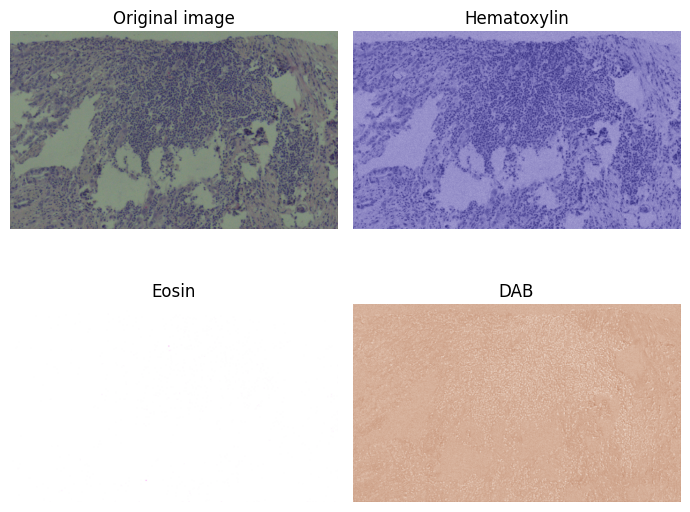

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from skimage import data
from skimage.color import rgb2hed, hed2rgb

# Example IHC image
# ihc_rgb = "/content/drive/MyDrive/images/1850cropped.png"

# Separate the stains from the IHC image
ihc_hed = rgb2hed(rgb)

# Create an RGB image for each of the stains
null = np.zeros_like(ihc_hed[:, :, 0])
ihc_h = hed2rgb(np.stack((ihc_hed[:, :, 0], null, null), axis=-1))
ihc_e = hed2rgb(np.stack((null, ihc_hed[:, :, 1], null), axis=-1))
ihc_d = hed2rgb(np.stack((null, null, ihc_hed[:, :, 2]), axis=-1))

# Display
fig, axes = plt.subplots(2, 2, figsize=(7, 6), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(ihc_rgb)
ax[0].set_title("Original image")

ax[1].imshow(ihc_h)
ax[1].set_title("Hematoxylin")

ax[2].imshow(ihc_e)
ax[2].set_title("Eosin")  # Note that there is no Eosin stain in this image

ax[3].imshow(ihc_d)
ax[3].set_title("DAB")

for a in ax.ravel():
    a.axis('off')

fig.tight_layout()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!cd /content/stainlib/

In [ ]:
pwd

'/content'

## Start Here

In [ ]:
!git clone https://github.com/crimefightingllama/Stainlib

Cloning into 'Stainlib'...
remote: Enumerating objects: 140, done.
remote: Counting objects: 100% (140/140), done.
remote: Compressing objects: 100% (116/116), done.
remote: Total 140 (delta 45), reused 111 (delta 20), pack-reused 0
Receiving objects: 100% (140/140), 10.14 MiB | 22.93 MiB/s, done.
Resolving deltas: 100% (45/45), done.


In [ ]:
!pip install -e Stainlib/

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/Stainlib
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 6.1 MB/s eta 0:00:00
  Running setup.py develop for stainlib


In [ ]:
# from Stainlib import stainlib
# import Stainlib
# import normalizer as nor
# from stainlib.stainlib import normalization
import os
os.chdir("/content/Stainlib")
import stainlib


In [ ]:
from PIL import Image
import numpy as np

def normalizestain(source):
  ihc_rgb = Image.open(source)
  print(np.array(ihc_rgb).shape)
  rgb = ihc_rgb.convert('RGB')
  rgb = np.uint8(rgb)
  target_image = "/content/drive/MyDrive/images/1850cropped512hd.png"
  rgb_target = Image.open(target_image)
  target_image = rgb_target.convert('RGB')
  # target_image = Image.fromarray(np.uint8(target_image))
  target_image = np.uint8(target_image)
  print(np.array(target_image).shape)
  print(type(np.array(target_image)[1][1][1]))
  source_image = rgb

  normalizer = stainlib.normalization.normalizer.ExtractiveStainNormalizer(method='vahadane')
  target = stainlib.utils.stain_utils.LuminosityStandardizer.standardize(target_image)
  normalizer.fit(target)
  to_transform = stainlib.utils.stain_utils.LuminosityStandardizer.standardize(source_image)
  transformed = normalizer.transform(to_transform)
  return transformed

In [ ]:
source = "/content/drive/MyDrive/images/A00_01.bmp"
transformed = normalizestain(source)

(2084, 2084, 3)
(724, 725, 3)
<class 'numpy.uint8'>


In [ ]:
transformed.shape

(3676, 3573, 3)

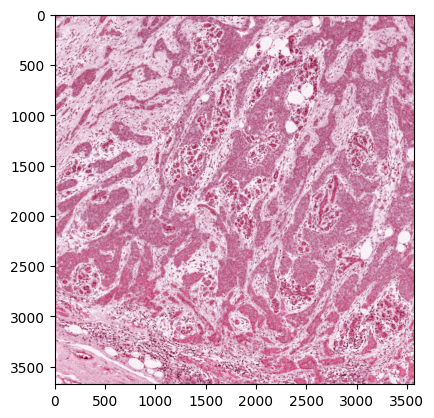

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(transformed_image)
plt.savefig("trA00_01.jpg",dpi = 300)

In [ ]:
Image.fromarray(transformed.astype('uint8') ,mode='RGB')

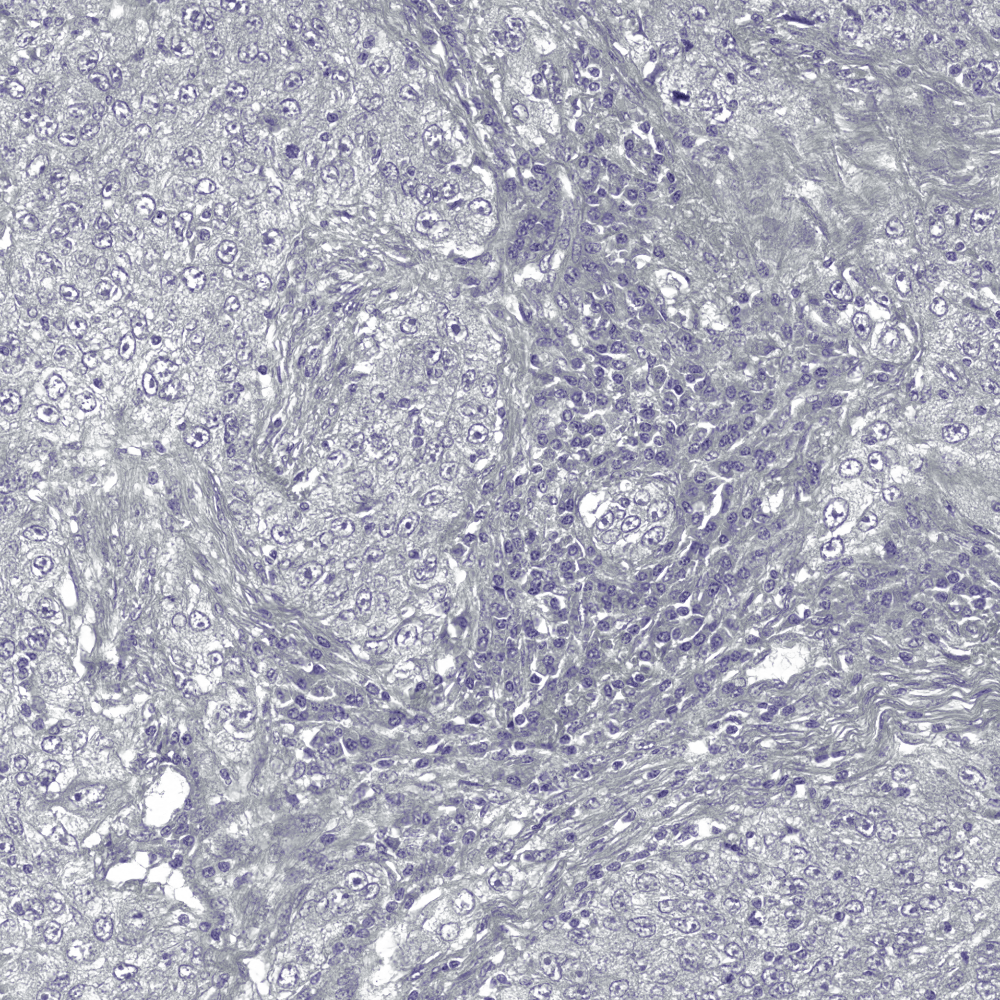

In [ ]:
transformed_image = Image.fromarray(transformed)
transformed_image.show()
transformed_image.save("/content/drive/MyDrive/images/trA00_01.bmp")

In [ ]:
!cp "/content/tr2533zenroi.bmp" "/content/drive/MyDrive/images"

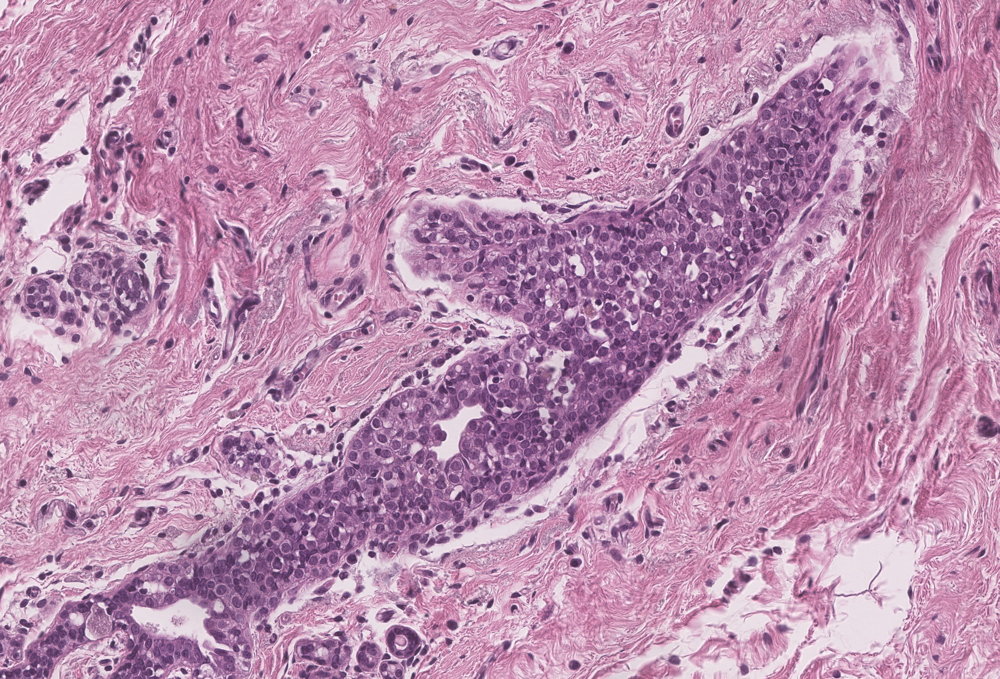

In [ ]:
target_image

In [ ]:
help(stainlib)

AttributeError: ignored

Now we can easily manipulate the hematoxylin and DAB channels:



In [ ]:
from skimage.exposure import rescale_intensity

# Rescale hematoxylin and DAB channels and give them a fluorescence look
h = rescale_intensity(ihc_hed[:, :, 0], out_range=(0, 1),
                      in_range=(0, np.percentile(ihc_hed[:, :, 0], 99)))
d = rescale_intensity(ihc_hed[:, :, 2], out_range=(0, 1),
                      in_range=(0, np.percentile(ihc_hed[:, :, 2], 99)))

# Cast the two channels into an RGB image, as the blue and green channels
# respectively
zdh = np.dstack((null, d, h))

fig = plt.figure()
axis = plt.subplot(1, 1, 1, sharex=ax[0], sharey=ax[0])
axis.imshow(zdh)
axis.set_title('Stain-separated image (rescaled)')
axis.axis('off')
plt.show()